In [1]:
import pandas as pd
import numpy as np
%matplotlib inline

from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor

In [2]:
meme = pd.read_csv('../data/processed/meme.csv')
ai = pd.read_csv('../data/processed/ai.csv')
rwa = pd.read_csv('../data/processed/rwa.csv')
gaming = pd.read_csv('../data/processed/gaming.csv')
meme.shape, ai.shape, rwa.shape, gaming.shape

((33039, 10), (113423, 10), (52339, 10), (125654, 10))

In [3]:
complete = pd.concat([meme, ai, rwa, gaming], axis=0)
print(complete.shape)
complete.head()

(324455, 10)


,timestamp,open,high,low,close,volume,name,symbol,id,category
0,1681689600,3.141154e-08,7.951914e-08,2.818250e-08,6.526480e-08,9.040237e+06,Pepe,PEPE,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,meme
1,1681776000,6.485267e-08,2.276132e-07,5.598800e-08,1.878306e-07,3.246056e+07,Pepe,PEPE,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,meme
2,1681862400,1.862740e-07,3.796318e-07,1.379781e-07,2.647504e-07,5.639813e+07,Pepe,PEPE,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,meme
3,1681948800,2.648534e-07,4.051020e-07,2.291480e-07,2.945193e-07,4.044670e+07,Pepe,PEPE,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,meme
4,1682035200,2.949180e-07,3.114699e-07,1.605779e-07,1.985193e-07,3.242627e+07,Pepe,PEPE,02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39,meme


In [4]:
complete.info()

<class 'pandas.core.frame.DataFrame'>
Index: 324455 entries, 0 to 125653
Data columns (total 10 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   timestamp  324455 non-null  int64  
 1   open       324455 non-null  float64
 2   high       324455 non-null  float64
 3   low        324455 non-null  float64
 4   close      324455 non-null  float64
 5   volume     324455 non-null  float64
 6   name       324455 non-null  object 
 7   symbol     324455 non-null  object 
 8   id         324455 non-null  object 
 9   category   324455 non-null  object 
dtypes: float64(5), int64(1), object(4)
memory usage: 27.2+ MB


In [5]:
duplicates = pd.read_csv('../data/raw/duplicates.csv')
print(duplicates.shape)
duplicates

(19, 4)


,id,name,symbol,category
0,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,SENATE,SENATE,gaming
1,0d8b00d2-9e0a-4489-891b-6e663a6fcd10,Turbo,TURBO,ai
2,1a5aa1bf-0512-4a7d-ac19-ddaccfbee99f,Katana Inu,KATA,gaming
3,1bc28038-aa5b-4e3d-9ad9-eaf8cbfed677,TokenFi,TOKEN,meme
4,1bc28038-aa5b-4e3d-9ad9-eaf8cbfed677,TokenFi,TOKEN,ai
5,1c1cd416-b027-4d73-9d4d-0a9edc63524d,Chromia,CHR,gaming
6,4885df43-d6b8-4aa2-ba26-245b24d09e50,Cere Network,CERE,gaming
7,68221f51-660f-4bed-88e4-680165a9be0c,Kadena,KDA,gaming
8,85ec7d3f-bc7a-4c7a-83c6-1685f18f42fb,Echelon Prime,PRIME,gaming
9,8b88329d-a168-4590-a664-110db3c90308,Phantasma,SOUL,gaming


In [6]:
for index, row in duplicates.iterrows():
    id = row['id']
    category = row['category']
    complete = complete[~((complete['id'] == id) & (complete['category'] == category))]

In [7]:
# check amount of record grouping by id and show it's corresponding name
token_info = complete.groupby('id')['name'].value_counts()
token_info.describe()

count     250.000000
mean     1211.248000
std       644.484591
min        51.000000
25%       941.750000
50%      1158.500000
75%      1422.500000
max      3701.000000
Name: count, dtype: float64

In [8]:
token_info.head()

id                                    name          
02e9c2cc-2e3b-45fe-b7bb-508cb23a3a39  Pepe               548
040f0133-1654-4e4e-85ac-417155ca814f  Bittensor          330
0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130  SENATE            1035
049abaff-71e0-4b1a-bcee-942cb1630222  Dark Frontiers     375
04ad4e18-9643-458b-b805-e2d767a161e4  Swash             1081
Name: count, dtype: int64

In [9]:
# get the ids from the ones that the value count is greater than 990
ids = token_info[token_info > 990].index.get_level_values(0).unique()
ids

Index(['0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130',
       '04ad4e18-9643-458b-b805-e2d767a161e4',
       '050cd820-2c82-4222-892c-e6f2859625c7',
       '05bf91a3-52e5-40ef-b09d-0c471617116e',
       '06963e10-2042-41d3-9583-acb4135460dc',
       '0844705f-10ed-42ca-b483-914b7d59e351',
       '0bb97d30-b5bb-45d6-b105-e49436cace0e',
       '0d0d9689-bf75-41ee-9555-aa2f2ca0186b',
       '0d1428e8-2b88-4314-9b1e-aa664b34a5fe',
       '0f2d0434-2ff5-4166-8d59-5cb1e5b102e1',
       ...
       'f14d3862-f857-4705-8fda-40da9c7aa198',
       'f2cfff3b-a8ae-434f-b9e3-1c81a0ba2f81',
       'f59f39ff-5230-42bb-acce-7767dc84cd83',
       'f5bf148f-d833-408a-83eb-50e12d2139ee',
       'fc58d32a-af0e-43db-be43-2ad2f257151c',
       'fcb726c7-364f-4252-8ee8-70b0bbbd8791',
       'fefa947d-7719-4915-b24f-29a25ab34e80',
       'fefc437d-46fa-4470-9ffe-e6c7219a1f9d',
       'ff9c05cd-d3f6-4495-b8d6-7e6530a6dcab',
       'ffaebc24-053e-428e-a84d-be836e4f8a3a'],
      dtype='object', name='id', length=181)

In [10]:
# filter the complete dataset with the ids that have more than 990 records
filtered = complete[complete['id'].isin(ids)]
print(filtered.shape)
filtered.head()

(267662, 10)


,timestamp,open,high,low,close,volume,name,symbol,id,category
548,1622851200,1.899321e-10,1.899321e-10,1.850572e-10,1.850572e-10,528.165422,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
549,1622937600,1.624784e-10,1.626550e-10,1.140629e-10,1.142160e-10,5652.080469,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
550,1623024000,9.419727e-11,1.027495e-10,9.412420e-11,1.027495e-10,246.141853,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
551,1623110400,1.364552e-10,1.364552e-10,1.097132e-10,1.097132e-10,6152.783113,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
552,1623196800,1.040116e-10,1.098746e-10,9.643564e-11,9.648047e-11,1502.344034,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [11]:
# get the first timestamp for each id
first_timestamp = filtered.groupby('id').timestamp.min()
print(first_timestamp.shape)
first_timestamp.head()

(181,)


id
0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130    1639526400
04ad4e18-9643-458b-b805-e2d767a161e4    1635638400
050cd820-2c82-4222-892c-e6f2859625c7    1571184000
05bf91a3-52e5-40ef-b09d-0c471617116e    1622851200
06963e10-2042-41d3-9583-acb4135460dc    1626220800
Name: timestamp, dtype: int64

In [12]:
first_timestamp.sort_values()

id
7d793fa7-5fc6-432a-b26b-d1b10769d42e    1409011200
57d1ac75-9212-45fc-9caa-2c0790c48398    1440460800
7ab662b2-2574-4e48-96ea-dc8eb4545a0b    1464048000
0d1428e8-2b88-4314-9b1e-aa664b34a5fe    1467676800
d1f48a57-2c48-4512-abd6-90e8c29e5aba    1493251200
                                           ...    
1a5aa1bf-0512-4a7d-ac19-ddaccfbee99f    1640217600
199c287f-3646-49cf-afd3-e17758f66cf0    1640649600
e365ad15-0867-4b03-864e-1ab59f21ef00    1640908800
c2973207-8df8-4210-82e7-1693d55c7ec5    1640908800
bc000886-31af-4aa1-9b4e-e0ec9546dfca    1641859200
Name: timestamp, Length: 181, dtype: int64

In [13]:
# show the minimum timestamp for all
max_min_timestamp = first_timestamp.max()
print(max_min_timestamp, pd.to_datetime(max_min_timestamp, unit='s'))

1641859200 2022-01-11 00:00:00


In [14]:
# in complete check in how many rows the timestamp is 1409011200
filtered = filtered[filtered.timestamp == max_min_timestamp]['id']

In [15]:
# from complete just remain the rows that are in filtered
complete = complete[complete['id'].isin(filtered)]
print(complete.shape)
complete.head()

(266601, 10)


,timestamp,open,high,low,close,volume,name,symbol,id,category
548,1622851200,1.899321e-10,1.899321e-10,1.850572e-10,1.850572e-10,528.165422,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
549,1622937600,1.624784e-10,1.626550e-10,1.140629e-10,1.142160e-10,5652.080469,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
550,1623024000,9.419727e-11,1.027495e-10,9.412420e-11,1.027495e-10,246.141853,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
551,1623110400,1.364552e-10,1.364552e-10,1.097132e-10,1.097132e-10,6152.783113,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
552,1623196800,1.040116e-10,1.098746e-10,9.643564e-11,9.648047e-11,1502.344034,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [16]:
token_info2 = complete.groupby('id')['name'].value_counts()
token_info2.describe()

count     180.000000
mean     1481.116667
std       531.027730
min       996.000000
25%      1092.250000
50%      1274.000000
75%      1528.000000
max      3701.000000
Name: count, dtype: float64

In [17]:
token_info2

id                                    name            
0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130  SENATE              1035
04ad4e18-9643-458b-b805-e2d767a161e4  Swash               1081
050cd820-2c82-4222-892c-e6f2859625c7  ROOBEE              1827
05bf91a3-52e5-40ef-b09d-0c471617116e  Catgirl             1093
06963e10-2042-41d3-9583-acb4135460dc  Mist                1179
                                                          ... 
fcb726c7-364f-4252-8ee8-70b0bbbd8791  The Graph           1399
fefa947d-7719-4915-b24f-29a25ab34e80  Bird.Money          1421
fefc437d-46fa-4470-9ffe-e6c7219a1f9d  Electra Protocol    1201
ff9c05cd-d3f6-4495-b8d6-7e6530a6dcab  inSure DeFi         1197
ffaebc24-053e-428e-a84d-be836e4f8a3a  Flux                1293
Name: count, Length: 180, dtype: int64

In [18]:
complete.duplicated(['id', 'timestamp']).sum()

0

In [19]:
complete['timestamp'] = pd.to_datetime(complete['timestamp'], unit='s')
complete.head()

,timestamp,open,high,low,close,volume,name,symbol,id,category
548,2021-06-05,1.899321e-10,1.899321e-10,1.850572e-10,1.850572e-10,528.165422,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
549,2021-06-06,1.624784e-10,1.626550e-10,1.140629e-10,1.142160e-10,5652.080469,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
550,2021-06-07,9.419727e-11,1.027495e-10,9.412420e-11,1.027495e-10,246.141853,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
551,2021-06-08,1.364552e-10,1.364552e-10,1.097132e-10,1.097132e-10,6152.783113,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
552,2021-06-09,1.040116e-10,1.098746e-10,9.643564e-11,9.648047e-11,1502.344034,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [20]:
# just remain the rows with timestamp greater or equal than 1641859200
complete = complete[complete.timestamp >= pd.to_datetime(max_min_timestamp, unit='s')]
print(complete.shape)
complete.head()

(179054, 10)


,timestamp,open,high,low,close,volume,name,symbol,id,category
663,2022-01-11,1.998704e-09,2.548288e-09,1.908135e-09,2.109732e-09,168384.013657,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
664,2022-01-12,2.021652e-09,3.001679e-09,1.859690e-09,2.267492e-09,158181.605737,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
665,2022-01-13,2.229984e-09,2.581070e-09,2.090303e-09,2.168495e-09,93030.106110,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
666,2022-01-14,2.156560e-09,2.597417e-09,2.024773e-09,2.208654e-09,95901.377317,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
667,2022-01-15,2.404226e-09,2.591479e-09,2.094595e-09,2.438863e-09,107107.316236,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [21]:
# reset the index
complete.reset_index(drop=True, inplace=True)

In [22]:
complete.head()

,timestamp,open,high,low,close,volume,name,symbol,id,category
0,2022-01-11,1.998704e-09,2.548288e-09,1.908135e-09,2.109732e-09,168384.013657,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
1,2022-01-12,2.021652e-09,3.001679e-09,1.859690e-09,2.267492e-09,158181.605737,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
2,2022-01-13,2.229984e-09,2.581070e-09,2.090303e-09,2.168495e-09,93030.106110,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
3,2022-01-14,2.156560e-09,2.597417e-09,2.024773e-09,2.208654e-09,95901.377317,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
4,2022-01-15,2.404226e-09,2.591479e-09,2.094595e-09,2.438863e-09,107107.316236,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [23]:
# Data manipulation
# ==============================================================================
import sys
import os
import warnings
import numpy as np
import pandas as pd

# Plots
# ==============================================================================
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from statsmodels.graphics.tsaplots import plot_acf

# Modelling and Forecasting
# ==============================================================================
import sklearn
import skforecast
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import RFECV
from sklearn.ensemble import  HistGradientBoostingRegressor
from skforecast.ForecasterAutoregMultiSeries import ForecasterAutoregMultiSeries
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import bayesian_search_forecaster
from skforecast.model_selection_multiseries import backtesting_forecaster_multiseries
from skforecast.model_selection_multiseries import bayesian_search_forecaster_multiseries
from skforecast.model_selection_multiseries import select_features_multiseries
from skforecast.plot import set_dark_theme
from skforecast.preprocessing import series_long_to_dict
from skforecast.preprocessing import exog_long_to_dict

# Warnings configuration
# ==============================================================================
warnings.filterwarnings('once')

color = '\033[1m\033[38;5;208m'
print(f"{color}Version skforecast: {skforecast.__version__}")
print(f"{color}Version scikit-learn: {sklearn.__version__}")
print(f"{color}Version pandas: {pd.__version__}")
print(f"{color}Version numpy: {np.__version__}")

Version skforecast: 0.13.0
Version scikit-learn: 1.5.2
Version pandas: 2.2.3
Version numpy: 1.26.4


c:\Users\andre\miniconda3\envs\crypto-model\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [24]:
# #standardize close in complete
# scaler = StandardScaler()
# complete['close'] = scaler.fit_transform(complete[['close']])
# complete.head()
# standardize open, high, low, close and volume
scaler = StandardScaler()
complete[['open', 'high', 'low', 'close', 'volume']] = scaler.fit_transform(complete[['open', 'high', 'low', 'close', 'volume']])
complete.head()

,timestamp,open,high,low,close,volume,name,symbol,id,category
0,2022-01-11,-0.105014,-0.105267,-0.104797,-0.104957,-0.154310,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
1,2022-01-12,-0.105014,-0.105267,-0.104797,-0.104957,-0.154410,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
2,2022-01-13,-0.105014,-0.105267,-0.104797,-0.104957,-0.155050,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
3,2022-01-14,-0.105014,-0.105267,-0.104797,-0.104957,-0.155021,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme
4,2022-01-15,-0.105014,-0.105267,-0.104797,-0.104957,-0.154911,Catgirl,CATGIRL,05bf91a3-52e5-40ef-b09d-0c471617116e,meme


In [25]:
series = complete[['timestamp', 'id', 'name', 'close']]
exog = complete[['timestamp', 'id', 'open', 'high', 'low', 'volume']]
series.shape, exog.shape

((179054, 4), (179054, 6))

In [26]:
# do one hot encode for category
# exog = pd.get_dummies(exog, columns=['category'], drop_first=True, dtype=np.float64)

In [27]:
exog.head()

,timestamp,id,open,high,low,volume
0,2022-01-11,05bf91a3-52e5-40ef-b09d-0c471617116e,-0.105014,-0.105267,-0.104797,-0.154310
1,2022-01-12,05bf91a3-52e5-40ef-b09d-0c471617116e,-0.105014,-0.105267,-0.104797,-0.154410
2,2022-01-13,05bf91a3-52e5-40ef-b09d-0c471617116e,-0.105014,-0.105267,-0.104797,-0.155050
3,2022-01-14,05bf91a3-52e5-40ef-b09d-0c471617116e,-0.105014,-0.105267,-0.104797,-0.155021
4,2022-01-15,05bf91a3-52e5-40ef-b09d-0c471617116e,-0.105014,-0.105267,-0.104797,-0.154911


In [28]:
exog.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 179054 entries, 0 to 179053
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   timestamp  179054 non-null  datetime64[ns]
 1   id         179054 non-null  object        
 2   open       179054 non-null  float64       
 3   high       179054 non-null  float64       
 4   low        179054 non-null  float64       
 5   volume     179054 non-null  float64       
dtypes: datetime64[ns](1), float64(4), object(1)
memory usage: 8.2+ MB


In [29]:
# series_dict = series_long_to_dict(
#     data      = complete,
#     series_id = 'id',
#     index     = 'timestamp',
#     values    = 'close',
#     freq      = 'D'
# )

# series_dict = series_long_to_dict(
#     data      = complete,
#     series_id = 'id',
#     index     = 'timestamp',
#     values    = 'close',
#     freq      = 'D'
# )

# exog_dict = exog_long_to_dict(
#     data      = exog,
#     series_id = 'id',
#     index     = 'timestamp',
#     freq      = 'D'
# )

features = ['close', 'open', 'high', 'low', 'close']

series_dict = {feature: series_long_to_dict(
                 data=complete, 
                 series_id='id', 
                 index='timestamp', 
                 values=feature, 
                 freq='D') for feature in features}

# exog_dict = {feature: exog_long_to_dict(
#                  data=exog, 
#                  series_id='id', 
#                  index='timestamp', 
#                  freq='D') for feature in features}

In [30]:
# end_train = '2024-01-01 00:00:00'
# series_dict_train = {k: v.loc[: end_train,] for k, v in series_dict.items()}
# exog_dict_train   = {k: v.loc[: end_train,] for k, v in exog_dict.items()}
# series_dict_test  = {k: v.loc[end_train:,] for k, v in series_dict.items()}
# exog_dict_test    = {k: v.loc[end_train:,] for k, v in exog_dict.items()}

In [31]:
# set_dark_theme()
# colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
# # Ensure there are enough colors
# if len(colors) < len(series_dict):
#     colors = colors * (len(series_dict) // len(colors) + 1)
# fig, axs = plt.subplots(20, 1, figsize=(20, 10), sharex=True)
# for i, s in enumerate(list(series_dict.values())[:20]):
#     axs[i].plot(s, label=s.name, color=colors[i])
#     axs[i].legend(loc='upper right', fontsize=8)
#     axs[i].tick_params(axis='both', labelsize=8)
#     axs[i].axvline(pd.to_datetime(end_train) , color='white', linestyle='--', linewidth=1) # End train

In [32]:
# for k in series_dict.keys():
#     print(f"{k}:")
#     try:
#         print(
#             f"\tTrain: len={len(series_dict_train[k])}, {series_dict_train[k].index[0]}"
#             f" --- {series_dict_train[k].index[-1]}"
#         )
#     except:
#         print(f"\tTrain: len=0")
#     try:
#         print(
#             f"\tTest : len={len(series_dict_test[k])}, {series_dict_test[k].index[0]}"
#             f" --- {series_dict_test[k].index[-1]}"
#         )
#     except:
#         print(f"\tTest : len=0")

In [33]:
# for k in series_dict.keys():
#     print(f"{k}:")
#     try:
#         print(f"\t{exog_dict[k].columns.to_list()}")
#     except:
#         print(f"\tNo exogenous variables")

In [34]:
regressor = HistGradientBoostingRegressor(random_state=123, max_depth=5)
forecaster = ForecasterAutoregMultiSeries(
                regressor          = regressor,
                lags               = 14,
                encoding           = "ordinal",
                dropna_from_series = False
            )

# forecaster.fit(series=series_dict_train, exog=exog_dict_train , suppress_warnings=True)
# forecaster

In [35]:
for feature in features:
    forecaster.fit(series=series_dict[feature], suppress_warnings=True)

In [36]:
steps_ahead = 60
predictions_x_days = forecaster.predict(steps=steps_ahead)

In [37]:
predictions_x_days

,0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130,04ad4e18-9643-458b-b805-e2d767a161e4,050cd820-2c82-4222-892c-e6f2859625c7,06963e10-2042-41d3-9583-acb4135460dc,0844705f-10ed-42ca-b483-914b7d59e351,0bb97d30-b5bb-45d6-b105-e49436cace0e,0d0d9689-bf75-41ee-9555-aa2f2ca0186b,0d1428e8-2b88-4314-9b1e-aa664b34a5fe,0f2d0434-2ff5-4166-8d59-5cb1e5b102e1,10e910bd-6f50-4085-bd78-fbbcde408d28,...,f14d3862-f857-4705-8fda-40da9c7aa198,f2cfff3b-a8ae-434f-b9e3-1c81a0ba2f81,f59f39ff-5230-42bb-acce-7767dc84cd83,f5bf148f-d833-408a-83eb-50e12d2139ee,fc58d32a-af0e-43db-be43-2ad2f257151c,fcb726c7-364f-4252-8ee8-70b0bbbd8791,fefa947d-7719-4915-b24f-29a25ab34e80,fefc437d-46fa-4470-9ffe-e6c7219a1f9d,ff9c05cd-d3f6-4495-b8d6-7e6530a6dcab,ffaebc24-053e-428e-a84d-be836e4f8a3a
2024-10-16,-0.104583,-0.104733,-0.104733,-0.104733,-0.102841,-0.102454,-0.101992,-0.104733,-0.104700,-0.104469,...,-0.104733,-0.039937,-0.104733,-0.104733,-0.104583,-0.103552,-0.085643,-0.104733,-0.104733,-0.100902
2024-10-17,-0.104530,-0.104673,-0.104673,-0.104673,-0.102841,-0.102454,-0.101992,-0.104673,-0.104627,-0.104397,...,-0.104673,-0.039139,-0.104673,-0.104673,-0.104530,-0.103544,-0.085511,-0.104673,-0.104673,-0.100902
2024-10-18,-0.104525,-0.104647,-0.104647,-0.104647,-0.102841,-0.102454,-0.101992,-0.104647,-0.104627,-0.104469,...,-0.104647,-0.039713,-0.104647,-0.104647,-0.104525,-0.103544,-0.085511,-0.104647,-0.104651,-0.100967
2024-10-19,-0.104525,-0.104647,-0.104647,-0.104647,-0.102841,-0.102454,-0.101992,-0.104647,-0.104583,-0.104397,...,-0.104647,-0.039139,-0.104647,-0.104647,-0.104525,-0.103544,-0.085511,-0.104647,-0.104647,-0.100967
2024-10-20,-0.104525,-0.104583,-0.104583,-0.104583,-0.102841,-0.102454,-0.101992,-0.104583,-0.104530,-0.104397,...,-0.104583,-0.039139,-0.104583,-0.104583,-0.104525,-0.103544,-0.085511,-0.104583,-0.104587,-0.100967
2024-10-21,-0.104474,-0.104530,-0.104530,-0.104530,-0.102841,-0.102454,-0.101992,-0.104530,-0.104525,-0.104397,...,-0.104530,-0.039139,-0.104530,-0.104530,-0.104474,-0.103544,-0.085511,-0.104530,-0.104530,-0.100967
2024-10-22,-0.104469,-0.104525,-0.104525,-0.104525,-0.102841,-0.102454,-0.101992,-0.104525,-0.104525,-0.104397,...,-0.104525,-0.039139,-0.104525,-0.104525,-0.104469,-0.103544,-0.085511,-0.104525,-0.104525,-0.100967
2024-10-23,-0.104469,-0.104525,-0.104525,-0.104525,-0.102841,-0.102454,-0.101992,-0.104525,-0.104525,-0.104397,...,-0.104525,-0.039139,-0.104525,-0.104525,-0.104469,-0.103544,-0.085511,-0.104525,-0.104525,-0.100967
2024-10-24,-0.104397,-0.104525,-0.104525,-0.104525,-0.102841,-0.102454,-0.101992,-0.104525,-0.104474,-0.104397,...,-0.104525,-0.039139,-0.104525,-0.104525,-0.104397,-0.103544,-0.085511,-0.104525,-0.104525,-0.100967
2024-10-25,-0.104397,-0.104474,-0.104474,-0.104474,-0.102841,-0.102454,-0.101992,-0.104474,-0.104469,-0.104397,...,-0.104474,-0.039139,-0.104474,-0.104474,-0.104397,-0.103544,-0.085511,-0.104474,-0.104474,-0.100967


In [38]:
series_dict

{'close': {'0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130': 2022-01-11   -0.082529
  2022-01-12   -0.078418
  2022-01-13   -0.077754
  2022-01-14   -0.079474
  2022-01-15   -0.079644
                  ...   
  2024-10-11   -0.104609
  2024-10-12   -0.104603
  2024-10-13   -0.104625
  2024-10-14   -0.104603
  2024-10-15   -0.104617
  Freq: D, Name: 0432c2ca-0dc4-44c5-bf0c-a2feaa4b3130, Length: 1009, dtype: float64,
  '04ad4e18-9643-458b-b805-e2d767a161e4': 2022-01-11   -0.104348
  2022-01-12   -0.104319
  2022-01-13   -0.104369
  2022-01-14   -0.104353
  2022-01-15   -0.104337
                  ...   
  2024-10-11   -0.104914
  2024-10-12   -0.104913
  2024-10-13   -0.104913
  2024-10-14   -0.104912
  2024-10-15   -0.104912
  Freq: D, Name: 04ad4e18-9643-458b-b805-e2d767a161e4, Length: 1009, dtype: float64,
  '050cd820-2c82-4222-892c-e6f2859625c7': 2022-01-11   -0.104931
  2022-01-12   -0.104929
  2022-01-13   -0.104929
  2022-01-14   -0.104927
  2022-01-15   -0.104929
                  ...   
 

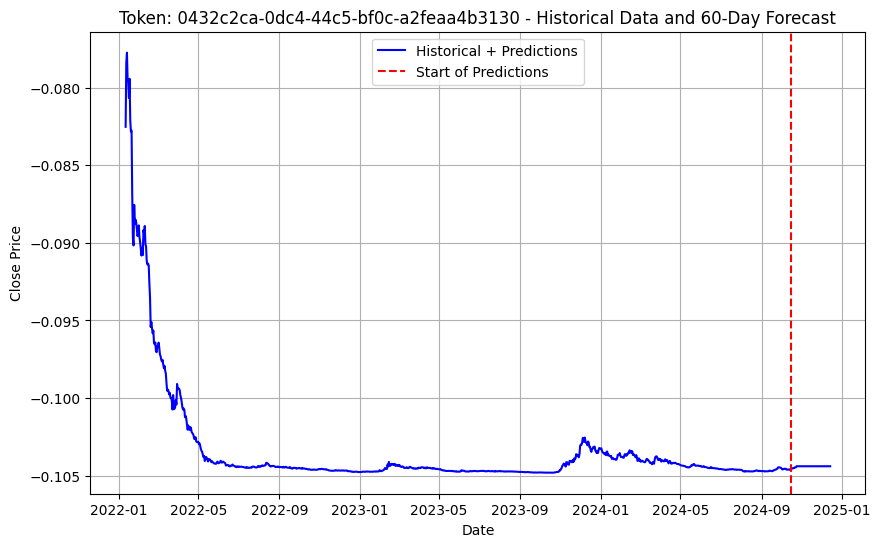

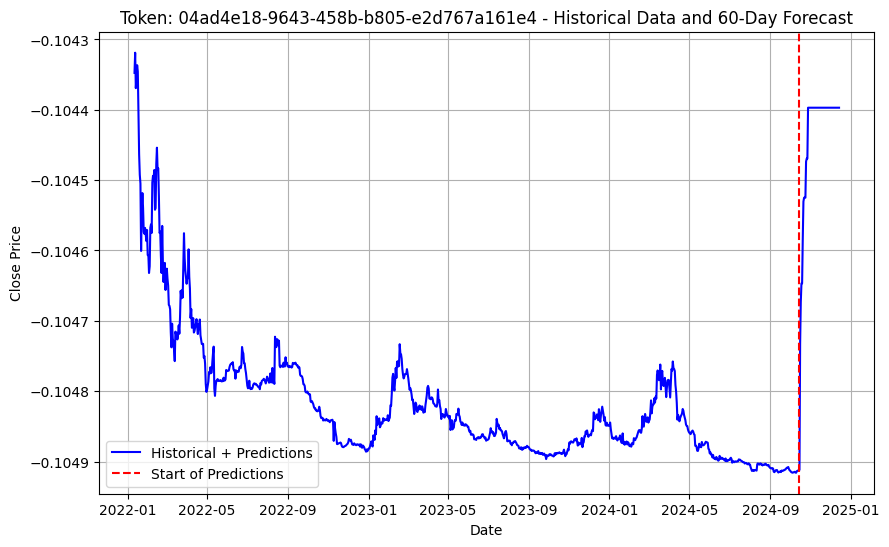

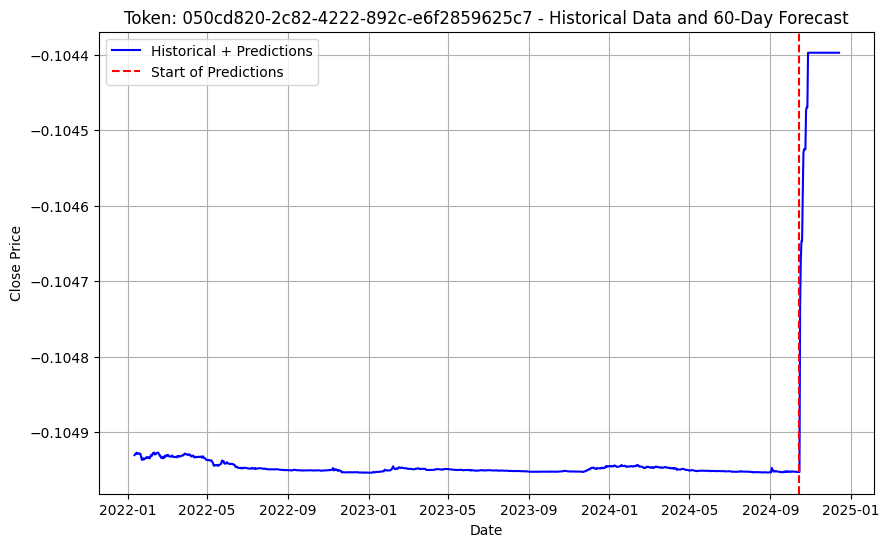

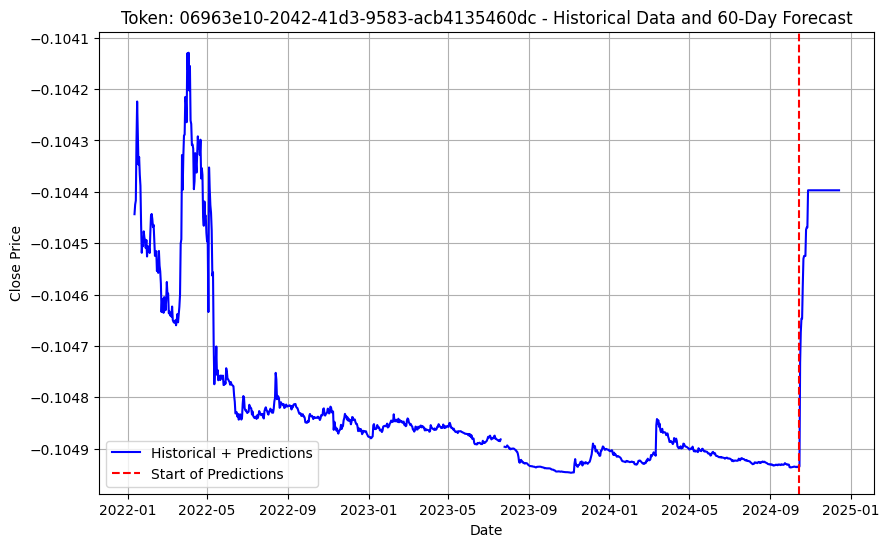

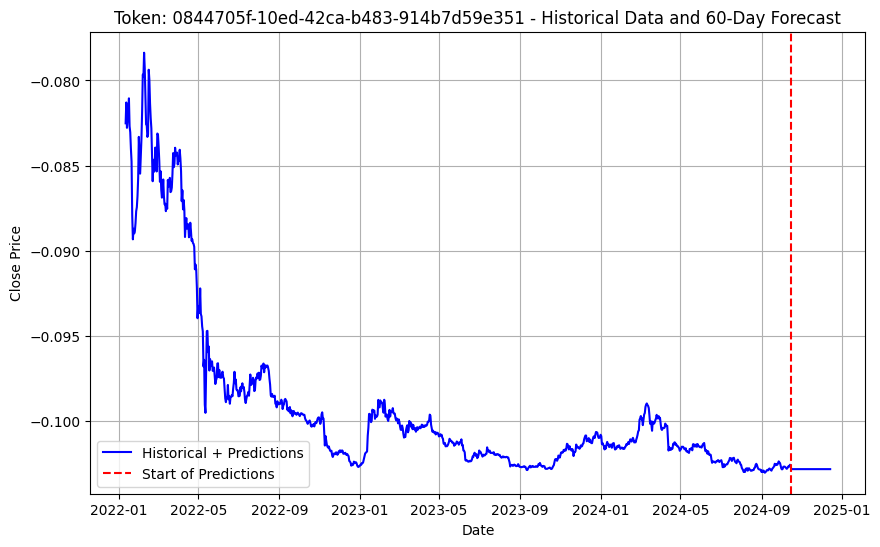

...

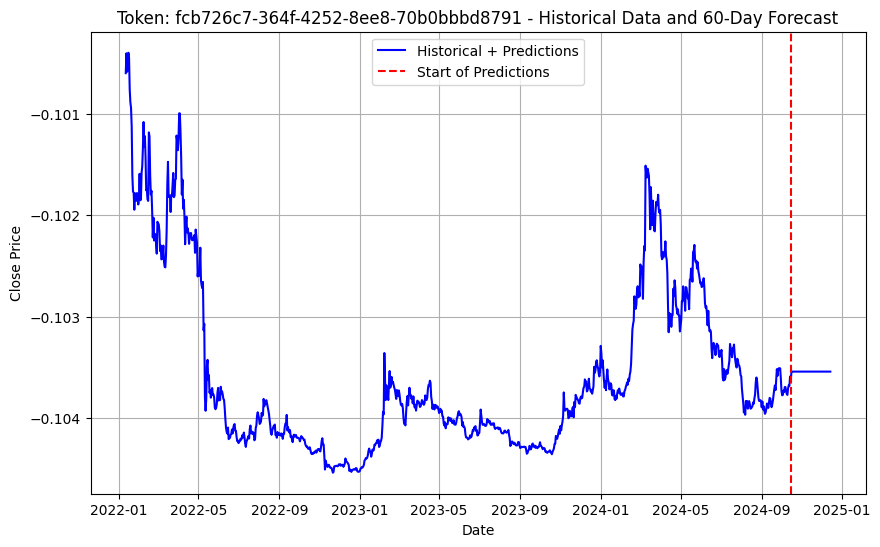

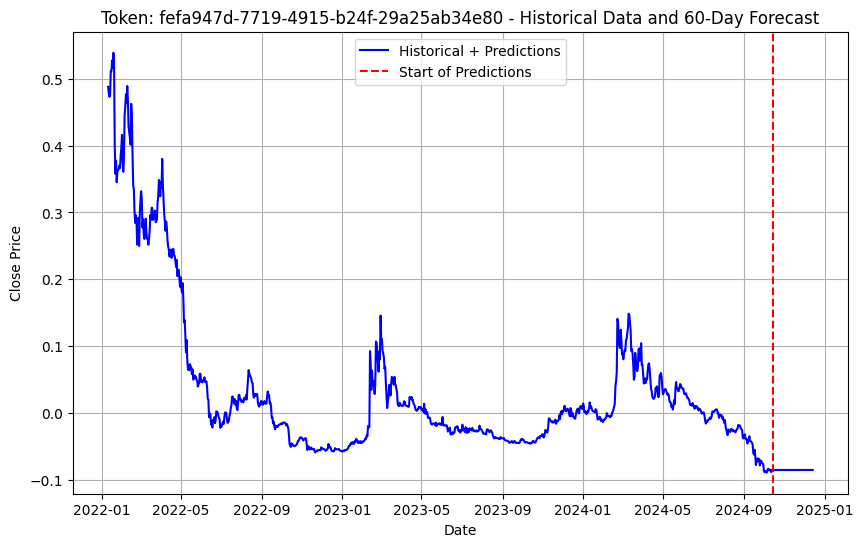

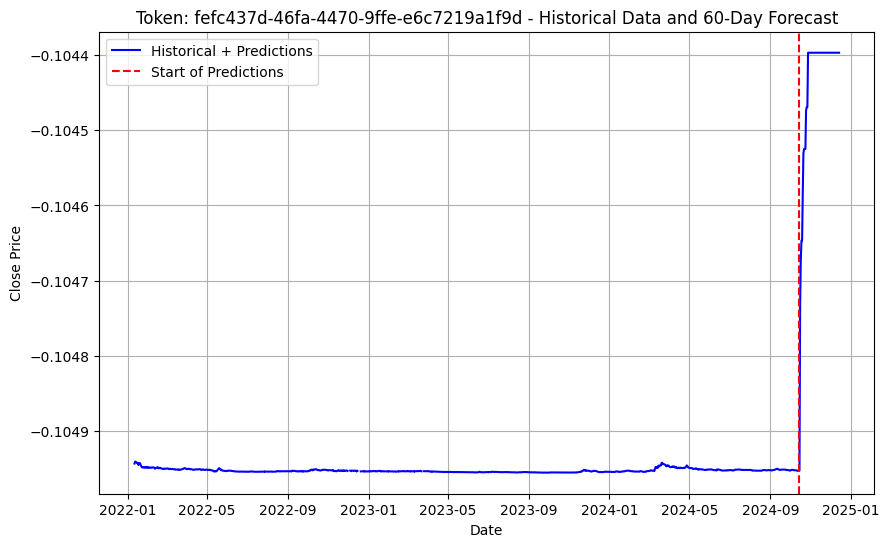

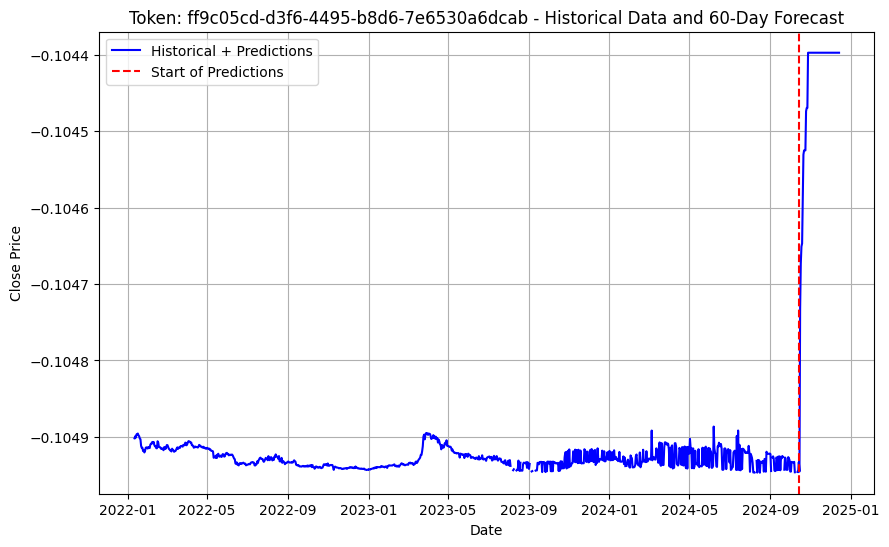

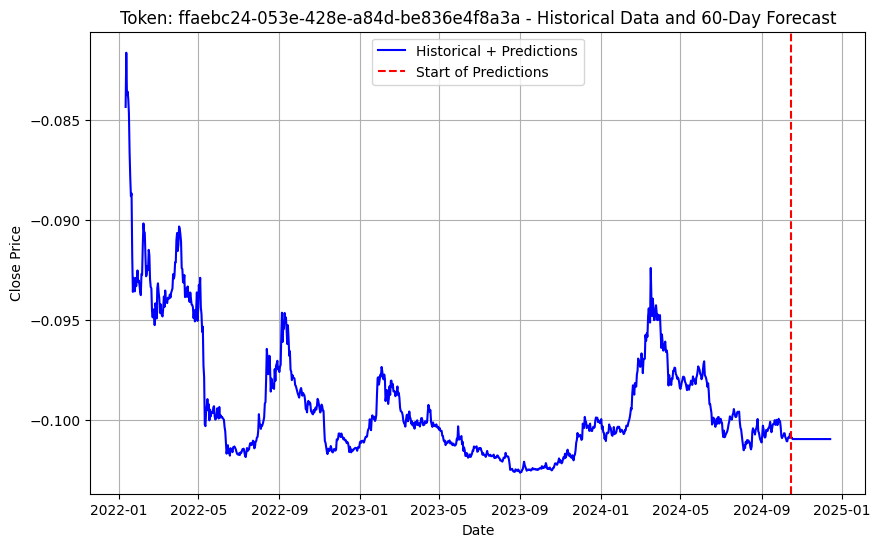

In [39]:
tokens = series_dict.keys()
for token_id, historical_data in series_dict['close'].items():
    # Extract the historical data for the token
    historical_data = historical_data  # historical close prices
    
    # Create a timeline for the predictions (future dates after the last historical data point)
    last_date = historical_data.index[-1]
    future_dates = pd.date_range(start=last_date, periods=steps_ahead+1, freq='D')[1:]  # Skip the last date
    
    # Get the predicted values for the token
    if token_id in predictions_x_days.columns:
        predictions = pd.Series(predictions_x_days[token_id], index=future_dates, name='Predictions')
    else:
        continue
    
    # Concatenate historical data with predictions
    combined_data = pd.concat([historical_data, predictions])
    
    # Plot the data
    plt.figure(figsize=(10, 6))
    plt.plot(combined_data.index, combined_data, label='Historical + Predictions', color='blue')
    plt.axvline(x=last_date, color='red', linestyle='--', label='Start of Predictions')
    plt.title(f'Token: {token_id} - Historical Data and 60-Day Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid(True)
    
    # Display plot
    plt.show()

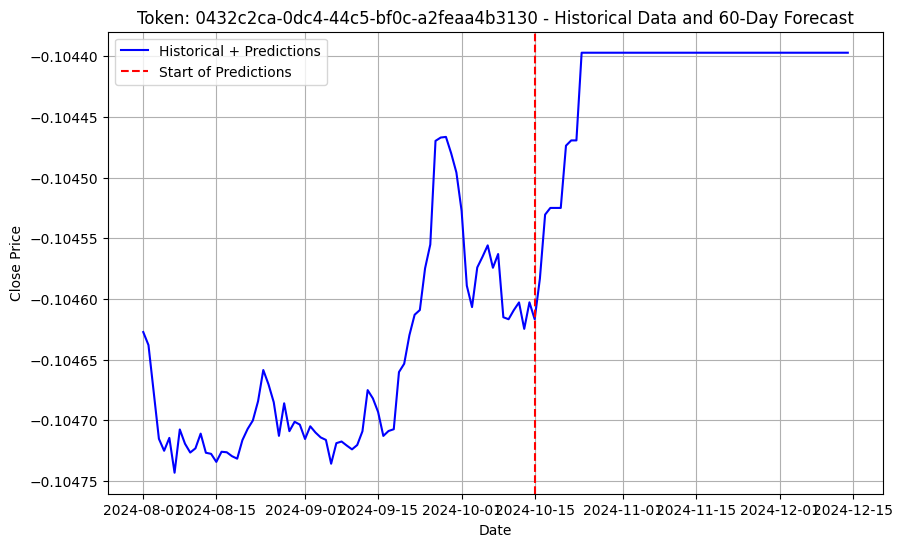

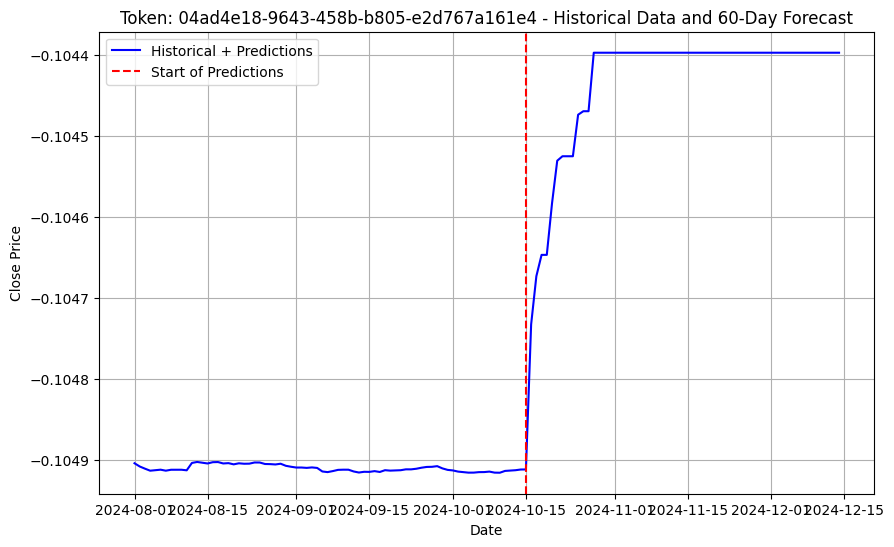

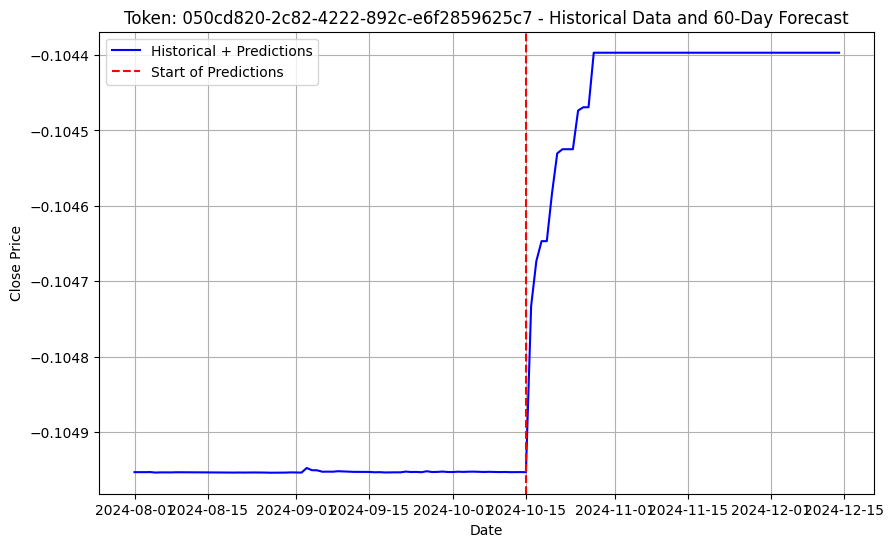

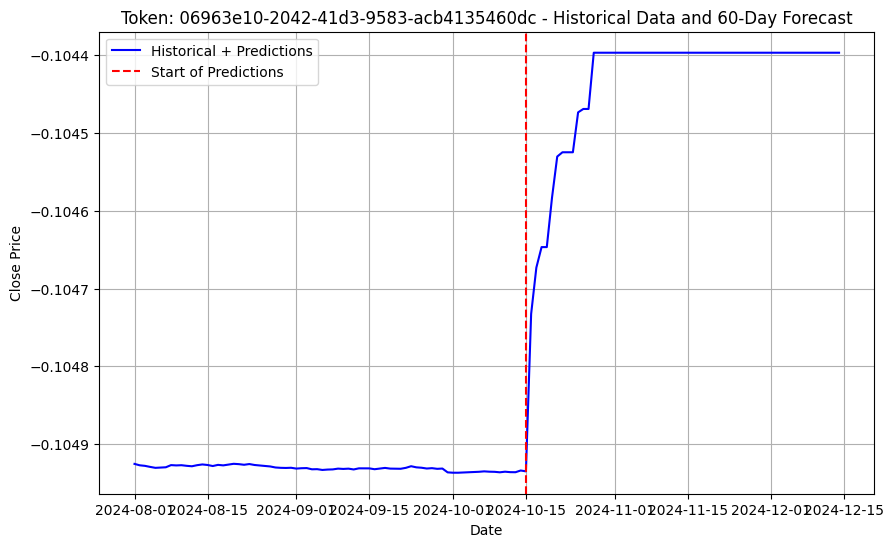

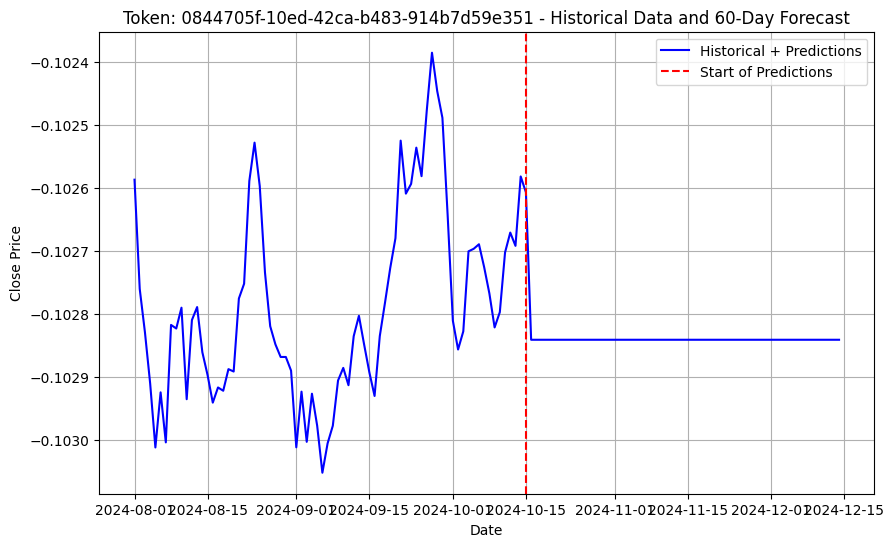

...

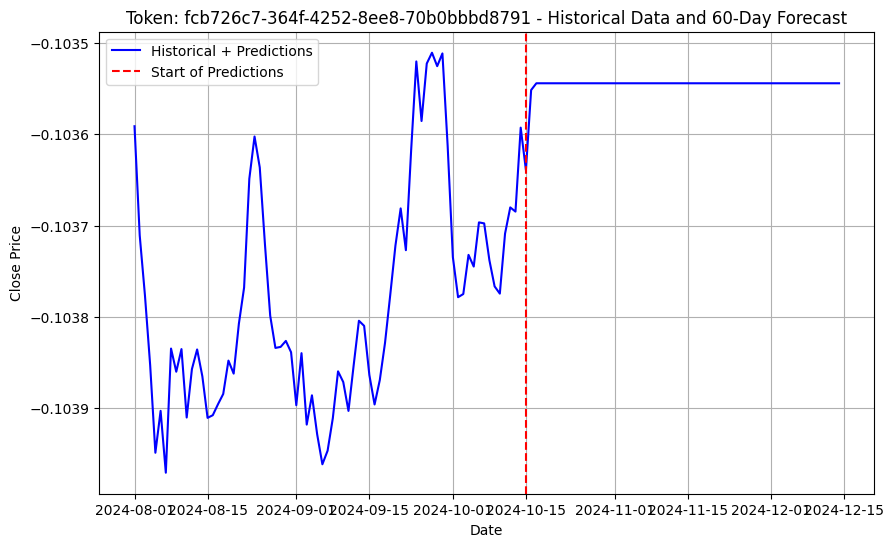

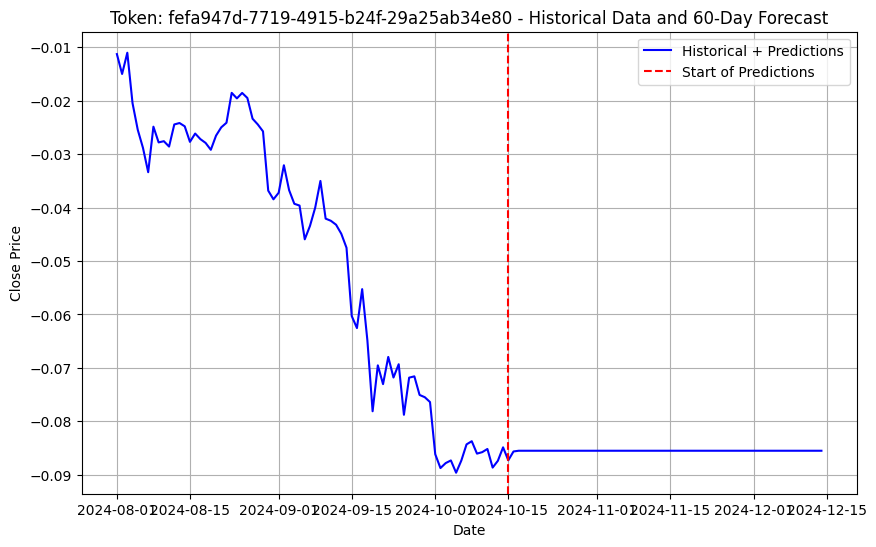

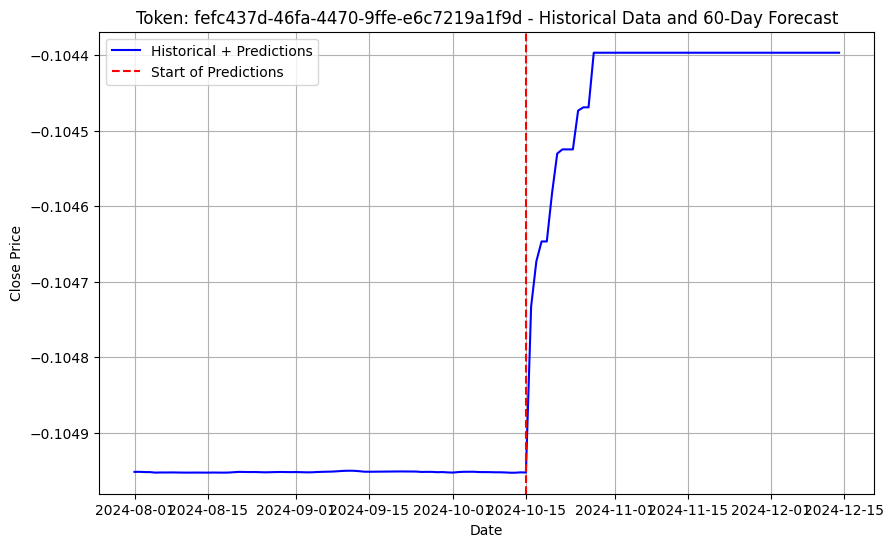

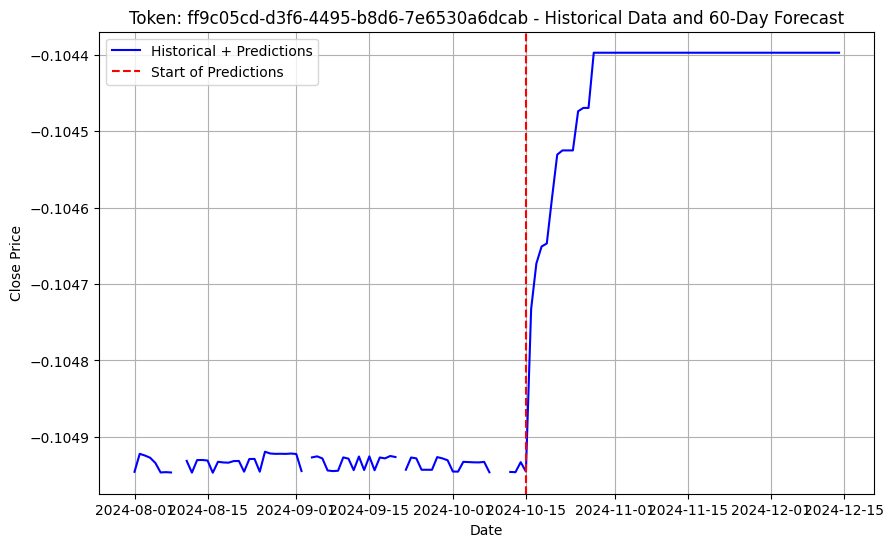

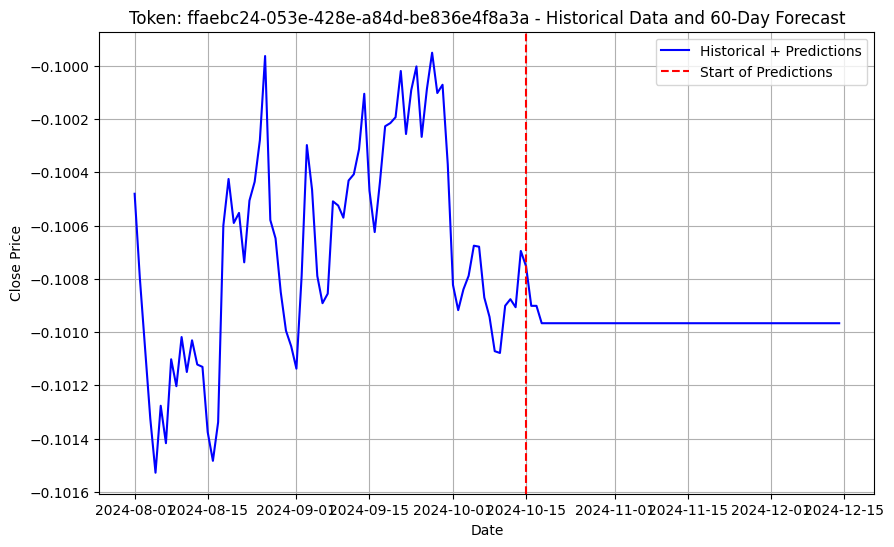

In [40]:
tokens = series_dict.keys()
for token_id, historical_data in series_dict['close'].items():
    # Extract the historical data for the token
    historical_data = historical_data  # historical close prices
    
    # Create a timeline for the predictions (future dates after the last historical data point)
    last_date = historical_data.index[-1]
    future_dates = pd.date_range(start=last_date, periods=steps_ahead+1, freq='D')[1:]  # Skip the last date
    
    # Get the predicted values for the token
    if token_id in predictions_x_days.columns:
        predictions = pd.Series(predictions_x_days[token_id], index=future_dates, name='Predictions')
    else:
        continue
    
    # Concatenate historical data with predictions
    combined_data = pd.concat([historical_data, predictions])
    
    # Filter data since 2024-08-01
    combined_data = combined_data[combined_data.index >= '2024-08-01']
    
    # Plot the data
    plt.figure(figsize=(10, 6))
    plt.plot(combined_data.index, combined_data, label='Historical + Predictions', color='blue')
    plt.axvline(x=last_date, color='red', linestyle='--', label='Start of Predictions')
    plt.title(f'Token: {token_id} - Historical Data and 60-Day Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid(True)
    
    # Display plot
    plt.show()